In [ ]:
!pip install pinecone-client datasets torch

In [1]:
import pinecone

pinecone.init(
    api_key="<<YOUR_API_KEY>>",
    environment="us-west1-gcp"
)
index = pinecone.Index("imagenet-query-trainer-clip")

In [2]:
from datasets import load_dataset

imagenet = load_dataset(
    'frgfm/imagenette',
    'full_size',
    split='train',
    ignore_verifications=False  # set to True if seeing splits Error
)
imagenet

Reusing dataset imagenette (/Users/jamesbriggs/.cache/huggingface/datasets/frgfm___imagenette/full_size/1.0.0/38929285b8abcae5c1305418e9d8fea5dd6b189bbbd22caba5f5537c7fa0f01f)


Dataset({
    features: ['image', 'label'],
    num_rows: 9469
})

We will start with a generic query, emulating that we don't really know what we're looking for. To create the embedding from that we need to use the natural language part of OpenAI's CLIP.

In [3]:
from transformers import CLIPTokenizerFast, CLIPModel

model_id = "openai/clip-vit-base-patch32"

tokenizer = CLIPTokenizerFast.from_pretrained(model_id)
model = CLIPModel.from_pretrained(model_id)

prompt = "dogs in the snow"

inputs = tokenizer(prompt, return_tensors="pt")
out = model.get_text_features(**inputs)
out.shape

torch.Size([1, 512])

As with our image embeddings, we get a `1, 512` dimension tensor. We perform the same steps to prepare it as a query vector `xq` for Pinecone.

In [4]:
out = out.squeeze(0)
out.shape

torch.Size([512])

In [5]:
import torch

xq = out.cpu().detach().numpy().tolist()
len(xq)

512

We retrieve `10` of the most similar records and store them in `xc`:

In [6]:
xc = index.query(xq, top_k=10, include_values=True)

`xc` contains more than just the vectors, it is a JSON object in the format:

```json
{
    'matches': [
        {
            'id': '<<ID of retrieved item #1>>',
            'score': 0.53,  # float value similarity score
            'values': [-0.22, 0.21, ...],  # the vector embedding itself
        },
        {
            'id': '<<ID of retrieved item #2>>',
            'score': 0.41,
            'values': [-0.19, 0.29, ...],
        },
        ...  # this continues for the 10 records we've returned
    ],
    'namespace': ''
}
```

We don't need all of this information, all we need are the ID values that we will convert to index values for extracting and displaying the images themselves, and the vectors for training the model.

In [7]:
# get the index values
idx = [int(match['id']) for match in xc['matches']]
idx

[5704, 6368, 6031, 6496, 6199, 5833, 6377, 6443, 6155, 5987]

In [8]:
# get the vectors
values = [match['values'] for match in xc['matches']]

Now we can see what these returned images look like.

5704


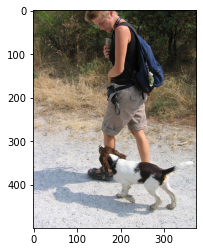

6368


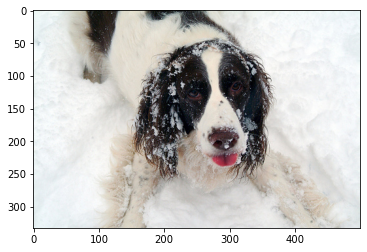

6031


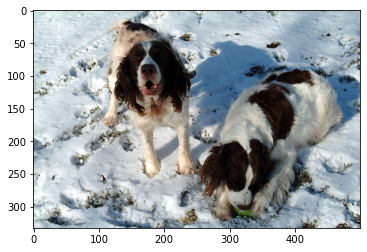

6496


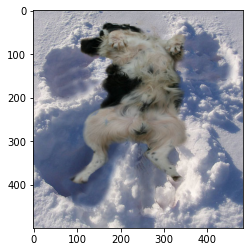

6199


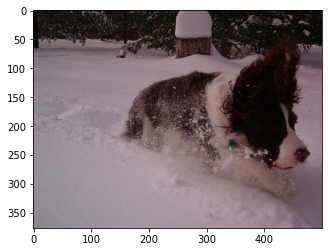

5833


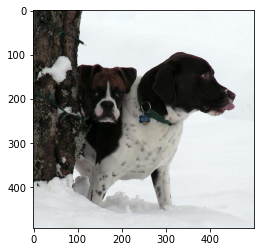

6377


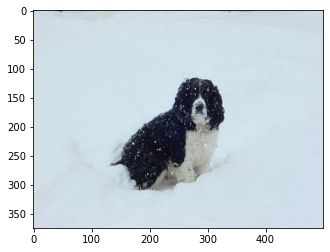

6443


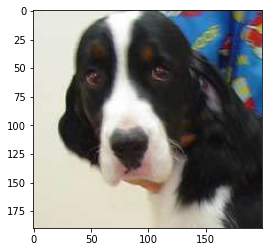

6155


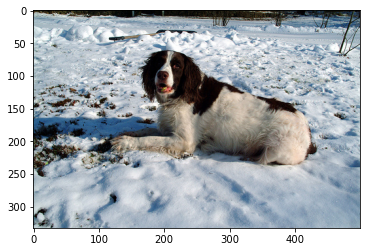

5987


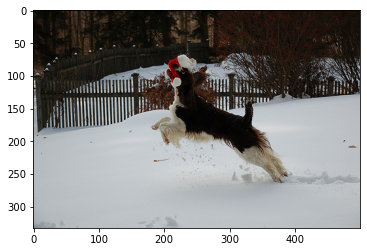

In [9]:
import matplotlib.pyplot as plt

for i in idx:
    print(i)
    plt.imshow(imagenet[i]['image'])
    plt.show()

First we try optimizing for more "dog in the snow" images, we do this by adding relevant image `idx` values to the `positives` list.

In [10]:
positives = [6368, 6031, 6496, 6199, 5833, 6377, 6155, 5987]
negatives = [i for i in idx if i not in positives]
print(f"Positives: {positives}\nNegatives: {negatives}")

Positives: [6368, 6031, 6496, 6199, 5833, 6377, 6155, 5987]
Negatives: [5704, 6443]


Now we extract the vector values extracted from Pinecone during the `query`, and prepare both these input values `X` and also some target labels `y`. We will use these to train our linear classifier.

In [11]:
# we need to extract the embeddings of the positives and negatives
positives = [
    match['values'] for match in xc['matches'] if int(match['id']) in positives
]
negatives = [
    match['values'] for match in xc['matches'] if int(match['id']) in negatives
]

In [12]:
# create the training inputs
X = positives + negatives
len(X)

10

We only have two labels, `-1` for irrelevant, and `1` for relevant.

In [13]:
# and create our labels (in this case only zeros)
y = [1] * len(positives) + [-1] * len(negatives)
y  # these are our target labels

[1, 1, 1, 1, 1, 1, 1, 1, -1, -1]

We will use a linear classifier model to learn the "perfect query" based on our selections. For this we will use a linear layer from PyTorch, find [install instructions for PyTorch here](https://pytorch.org), or just do following (not recommended):

```
!pip install torch
```

In [14]:
import torch

# initialize the model with 512 input size and one output
model = torch.nn.Linear(512, 1)

# convert previous query `xq` to tensor paramater for initial model weights
init_weight = torch.Tensor(xq).reshape(1, -1)
model.weight = torch.nn.Parameter(init_weight)

# init loss and optimizer
loss = torch.nn.BCEWithLogitsLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.2)

Now we have our model and first training batch ready, we can perform a training loop with our classifier, which we will define in a function called `fit`:

In [15]:
model.train()  # switch model to training mode

def fit(X: list, y: list, iters: int = 5):
    for _ in range(iters):
        # get predictions
        out = model(torch.Tensor(X))
        # calculate loss
        loss_value = loss(out, torch.Tensor(y).reshape(-1, 1))
        # reset gradients
        optimizer.zero_grad()
        # backpropagate
        loss_value.backward()
        # update weights
        optimizer.step()

In [16]:
# train
fit(X, y)

Now we extract a new query vector from the model weights:

In [17]:
model.weight.shape

torch.Size([1, 512])

We need to convert this to a flat list for Pinecone:

In [18]:
xq = model.weight.detach().numpy()[0].tolist()

Now before we search again we must mark the already retrieved vectors so that we don't retrieve them again. We do this using metadata filtering in Pinecone.

In [19]:
# we must update one record at a time
for i in idx:
    index.update(str(i), set_metadata={"seen": 1})

Now search using the new query vector.

7672


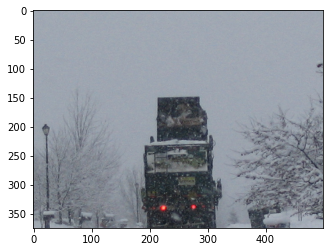

7599


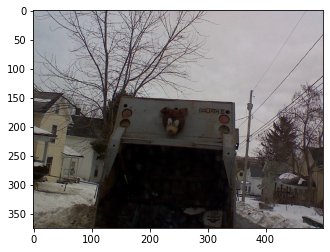

6573


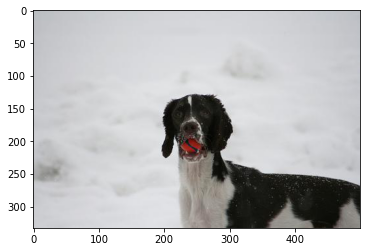

2849


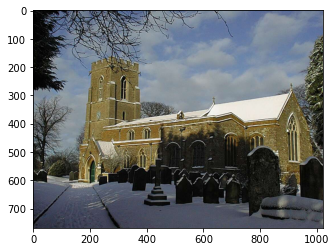

5990


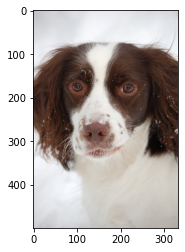

6200


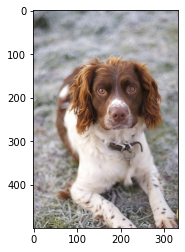

5730


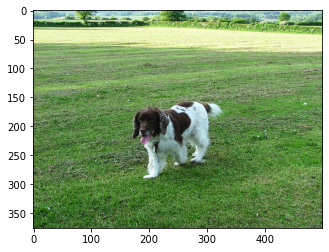

3120


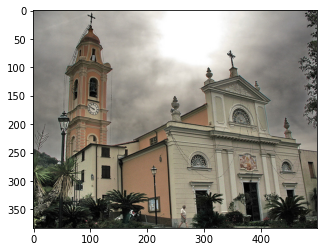

6105


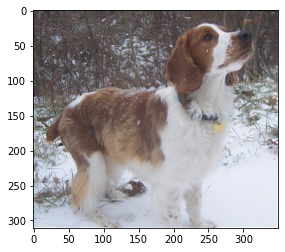

6054


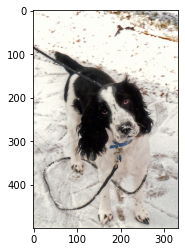

In [20]:
# retrieve most similar records
xc = index.query(
    xq,
    top_k=10,
    include_values=True,
    filter={"seen": 0}
)
# extract index and vector values
idx = [int(match['id']) for match in xc['matches']]
values = [match['values'] for match in xc['matches']]

# visualize the results
for i in idx:
    print(i)
    plt.imshow(imagenet[i]['image'])
    plt.show()

We will work through a few searches here. So let's clean up our code a little starting with the tuning operation. All we'll do here is place all of the previous logic into a function called `tune`:

In [21]:
def tune(positives, xc, idx, update=True):
    # confirm any positives actually exist
    for i in positives:
        assert i in idx
    # extract positive and negative vectors
    negatives = [i for i in idx if i not in positives]
    positives = [
        match['values'] for match in xc['matches'] if int(match['id']) in positives
    ]
    negatives = [
        match['values'] for match in xc['matches'] if int(match['id']) in negatives
    ]
    # create target labels
    y = [1] * len(positives) + [-1] * len(negatives)
    # create training inputs
    X = positives + negatives
    # train
    fit(X, y)
    # extract new query vector
    xq = model.weight.detach().numpy()[0].tolist()
    # and update the "seen" metadata
    if update:
        # we must update one record at a time
        for i in idx:
            index.update(str(i), set_metadata={"seen": 1})
    return xq

Now we update the model and query (now looking for any dog images - we will try to traverse to dogs in fields):

In [22]:
positives = [6573, 6105, 6200, 5730, 6054]
xq = tune(positives, xc, idx)

Now we return to retrieving more images. Again, let's collate all of the logic from before into a single `get_top_k` function:

In [23]:
def get_top_k(xq, top_k=10):
    # query the index
    xc = index.query(
        xq,
        top_k=top_k,
        include_values=True,
        filter={"seen": 0}
    )
    # extract IDs and vectors
    idx = [int(match['id']) for match in xc['matches']]
    values = [match['values'] for match in xc['matches']]
    # show retrieved images
    for i in idx:
        print(i)
        plt.imshow(imagenet[i]['image'])
        plt.show()
    return idx, xc

Now we retrieve those records:

5932


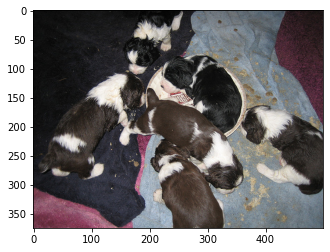

6423


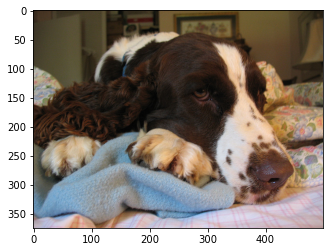

6405


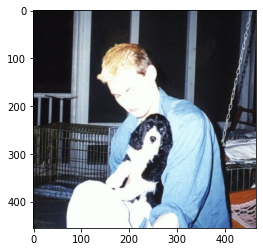

6407


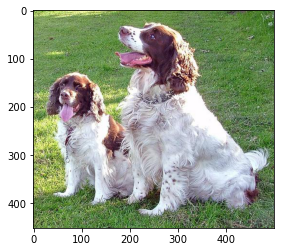

5830


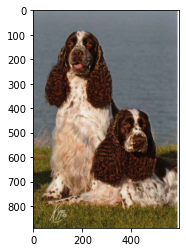

6453


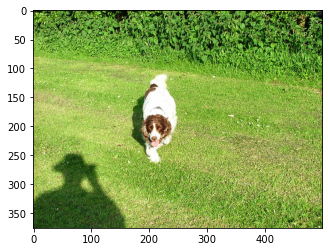

6126


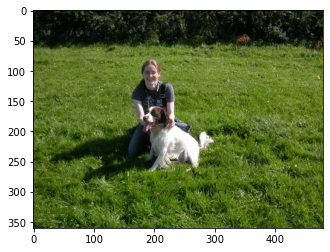

6084


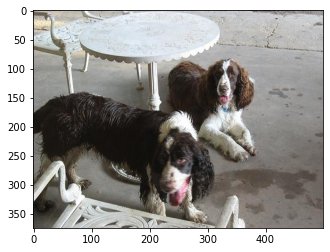

5792


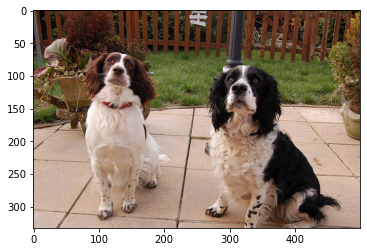

5663


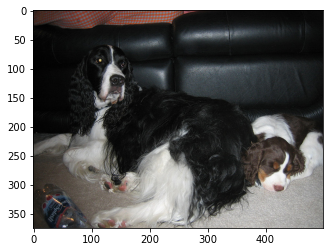

In [24]:
idx, xc = get_top_k(xq)

Okay we have some dogs in grassy fields, let's try and push the query towards more of these, we will need to mark some dog images as irrelevant for this.

3512


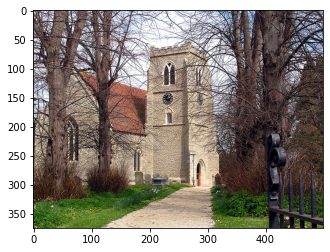

1964


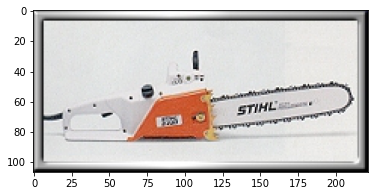

771


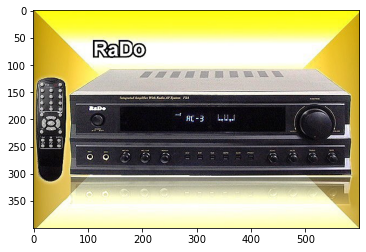

8250


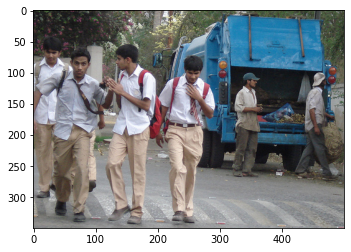

572


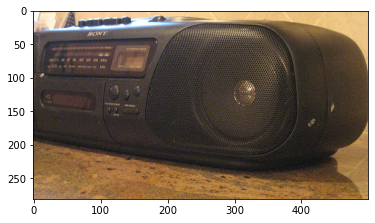

7614


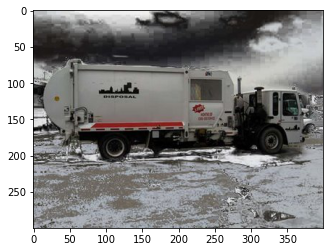

3875


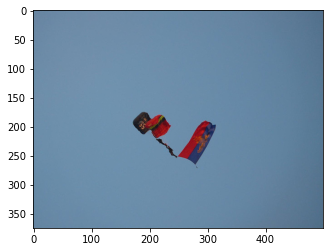

7954


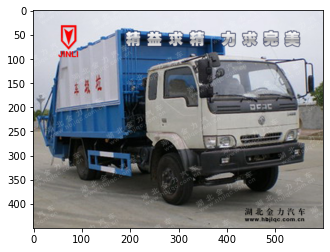

1465


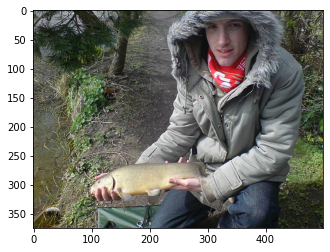

7595


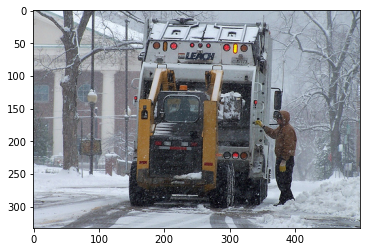

In [25]:
positives = [6453, 6126, 5792, 6407]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

As we're performing multiple training steps with a high learning rate (`lr`), the model is pretty responsive and moves quickly, in this case the model likely saw the negative dog examples and pulled us away from the dog vectors. We mark all of these as negatives.

6748


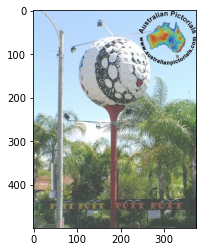

8966


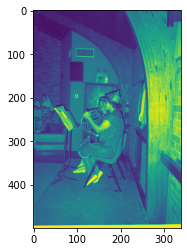

9206


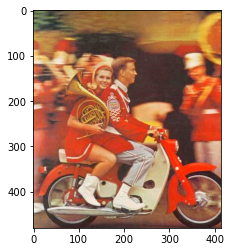

8982


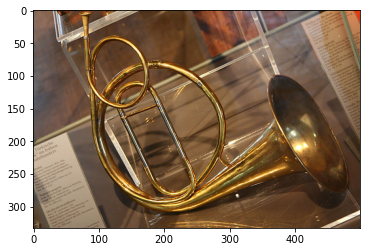

8847


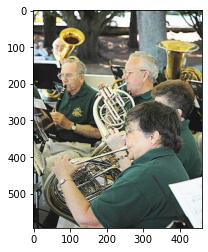

8557


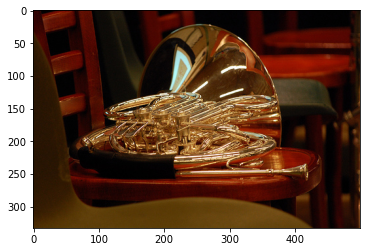

7004


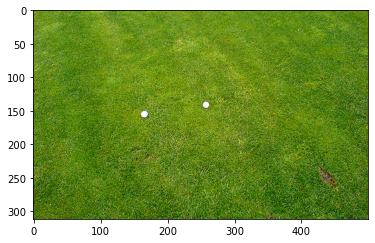

6722


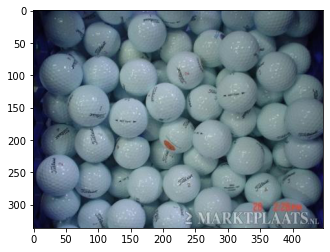

7324


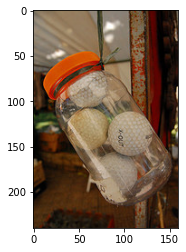

2497


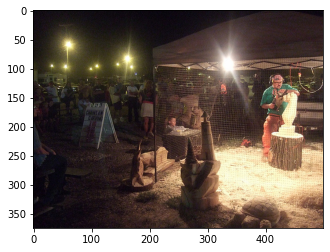

In [26]:
positives = []
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Now we need to focus on returning to the dog vector space, so we mark all dog images as relevant.

3967


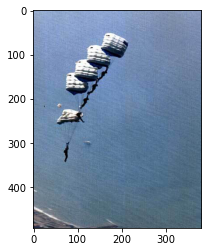

1859


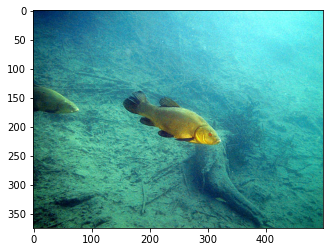

2874


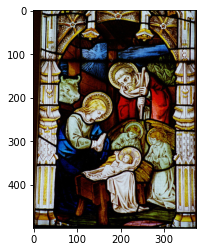

3674


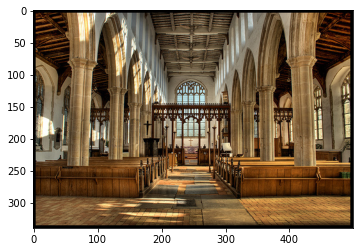

4563


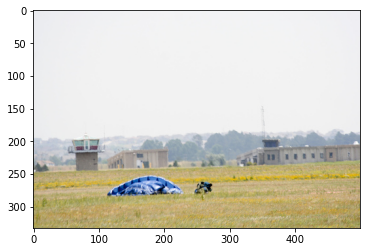

2191


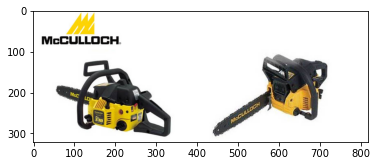

3917


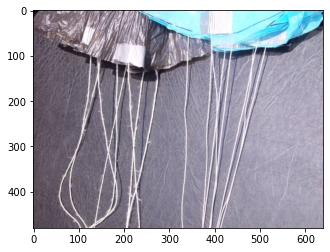

4454


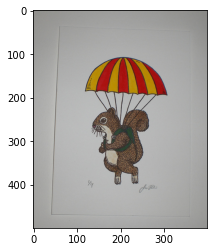

2487


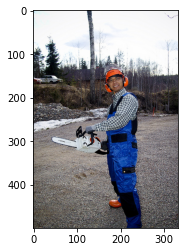

382


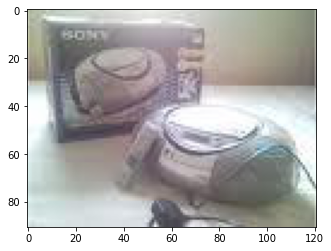

In [27]:
positives = [7004]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

1310


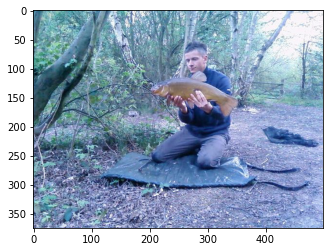

6058


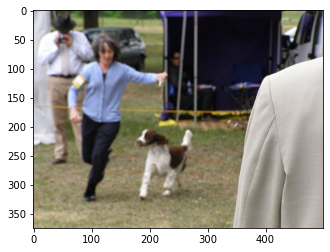

6191


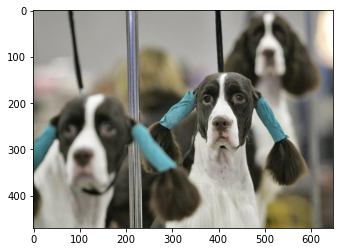

1133


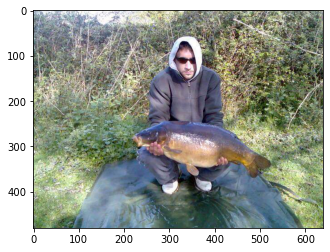

7340


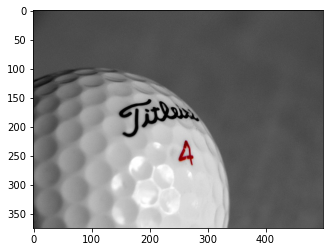

1054


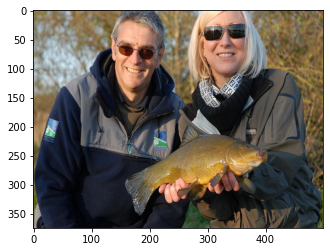

1327


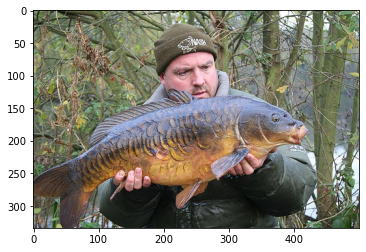

1082


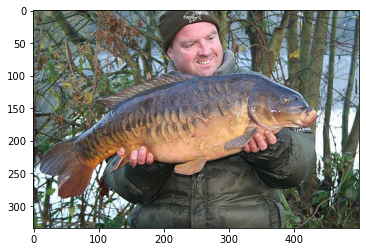

1873


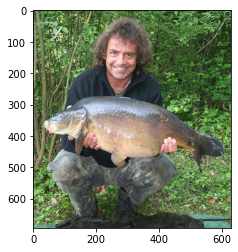

609


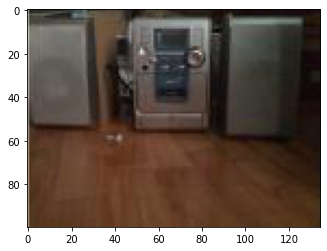

In [28]:
positives = []
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We do have two dog show images here, we'll mark both as relevant.

6554


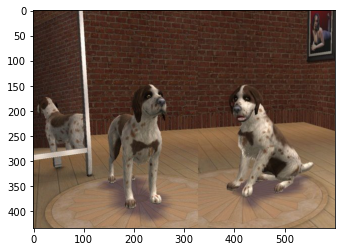

5930


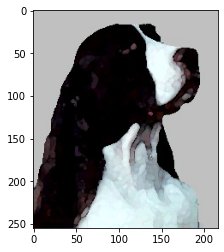

5326


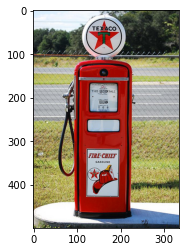

7208


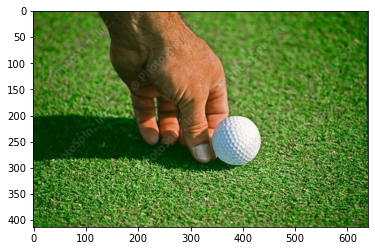

5410


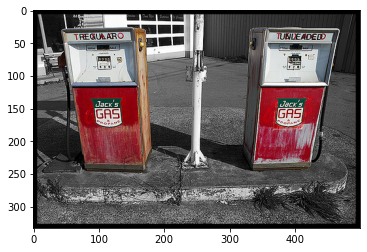

4972


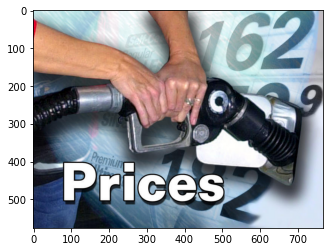

690


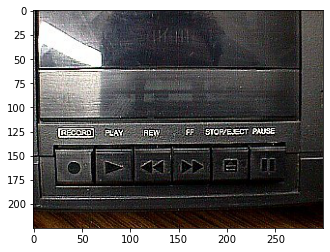

205


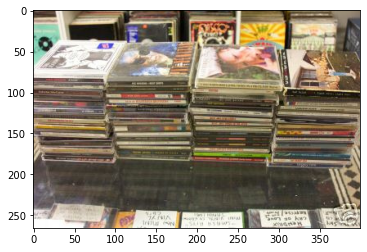

28


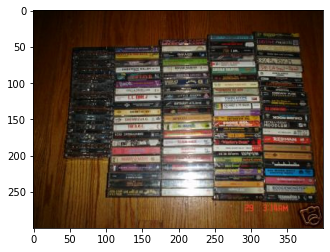

6169


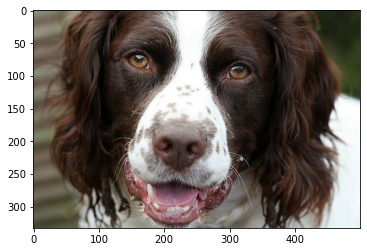

In [29]:
positives = [6058, 6191]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

5854


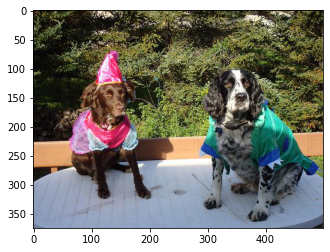

5725


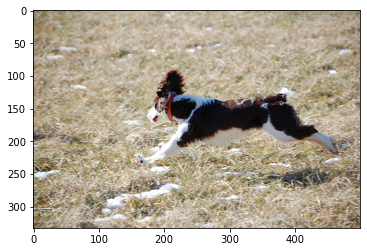

5860


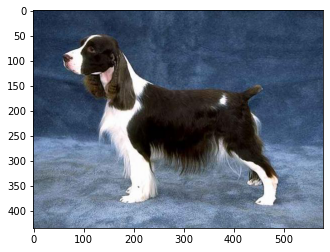

6340


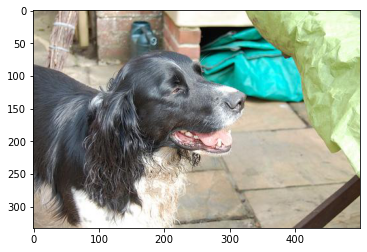

6076


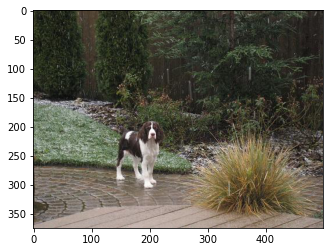

5954


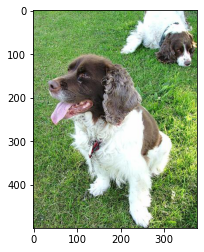

6273


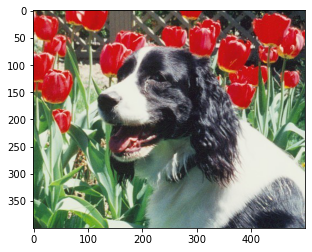

6487


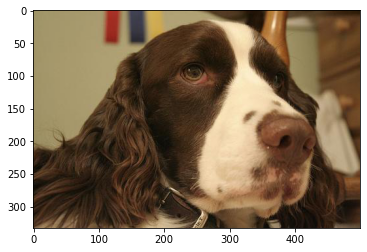

6033


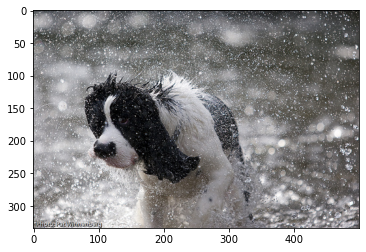

6444


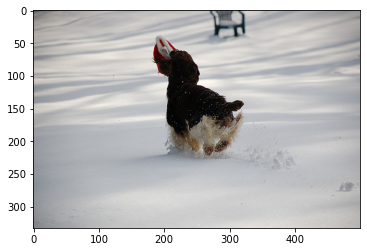

In [30]:
positives = [6554, 5930, 6169]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

6513


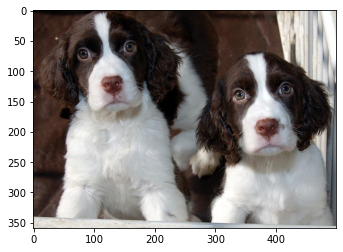

5647


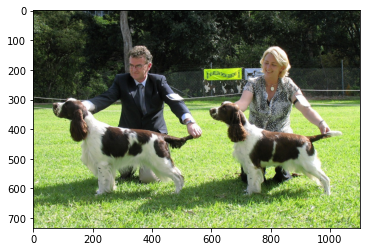

5668


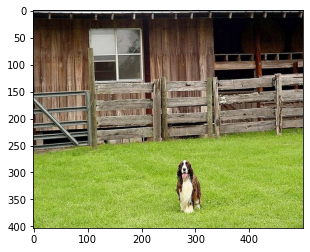

6298


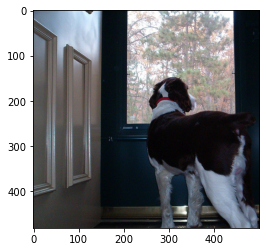

6264


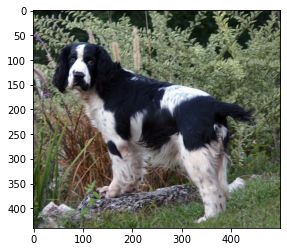

6032


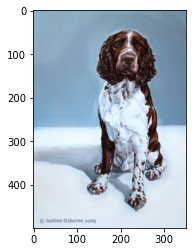

6160


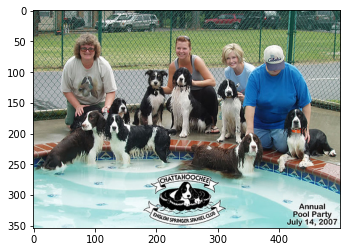

5999


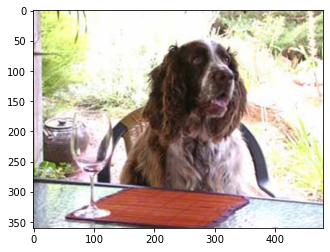

5848


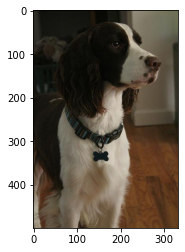

2515


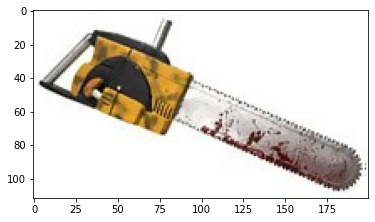

In [31]:
positives = [5854, 5725, 5860, 6076, 5954]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We're getting closer to dog show territory, dog show(ish) images and other similar images as positives.

6561


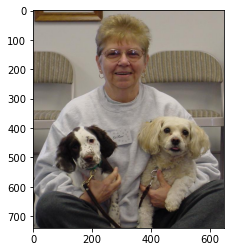

6121


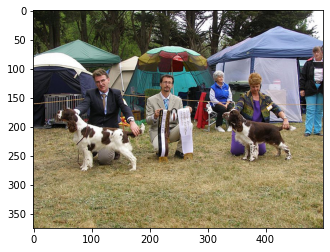

6011


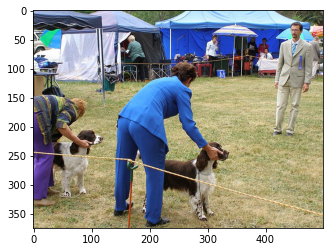

6508


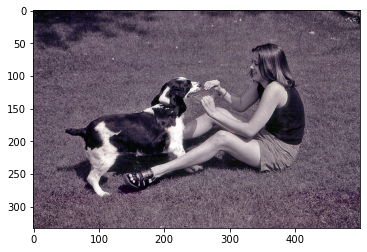

5756


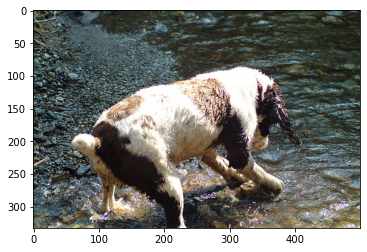

6364


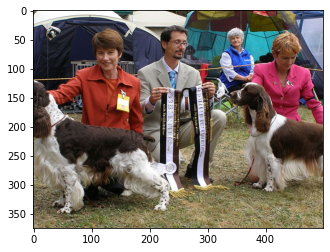

6376


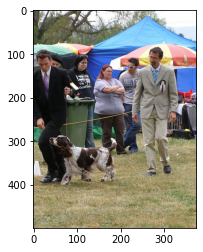

5658


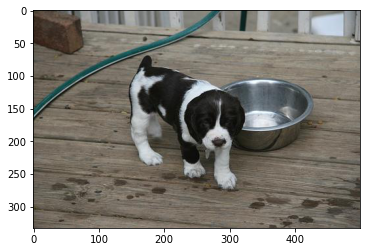

5836


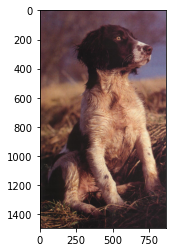

5782


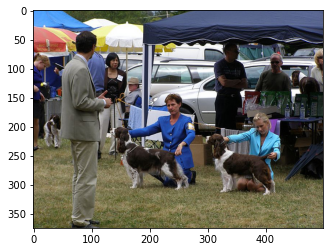

In [33]:
positives = [5647, 5668, 6264, 6160]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We're pulling in more dogs show images...

6141


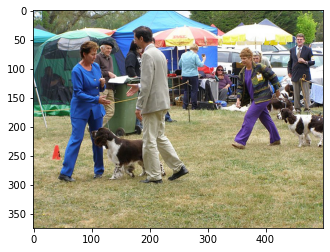

6293


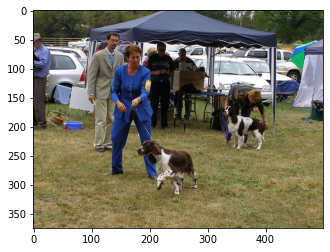

6558


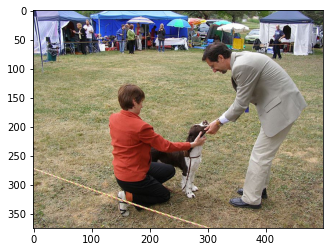

6350


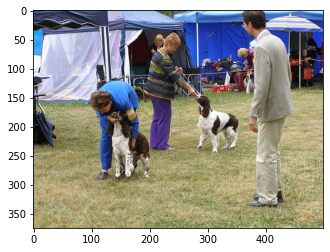

5981


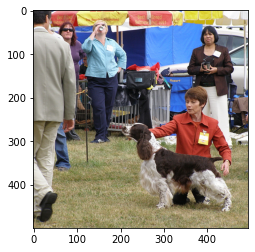

5898


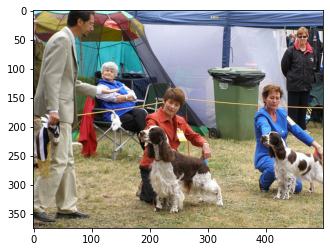

6122


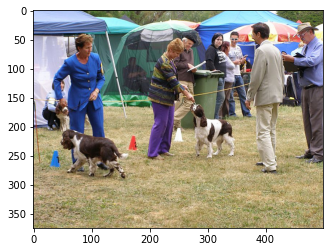

5877


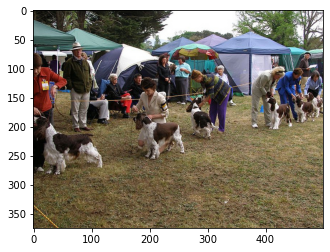

6210


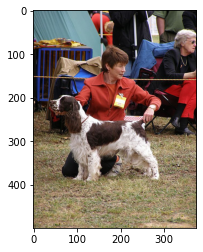

5734


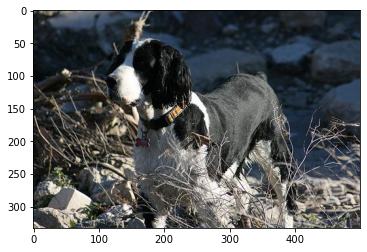

In [34]:
positives = [6121, 6011, 6364, 6376, 5782]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We're definitely in dog show territory, we'll mark a few more dog show images as relevant.

6353


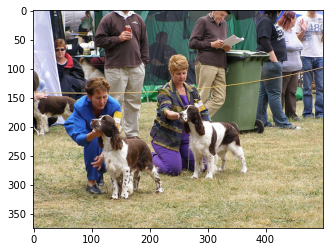

6485


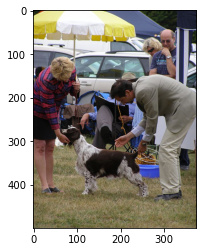

6208


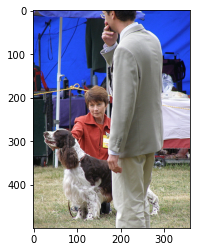

6436


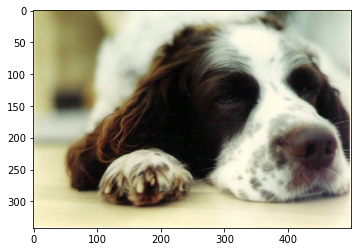

6379


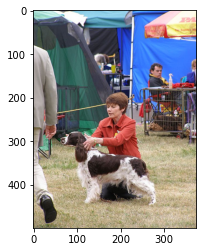

6116


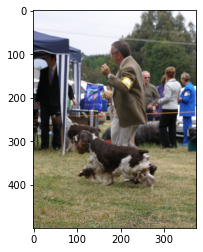

5753


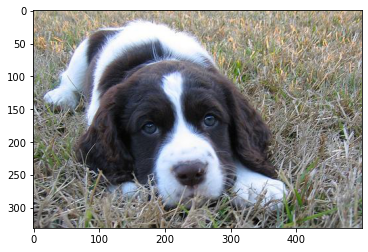

6455


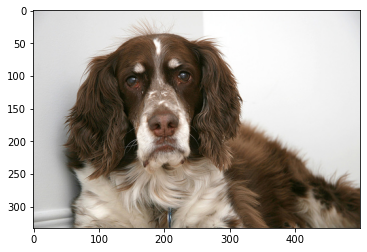

6589


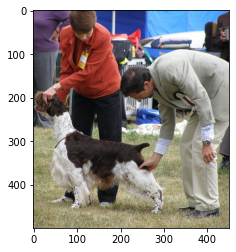

6538


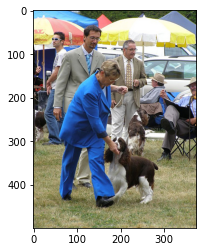

In [35]:
positives = [i for i in idx if i != 5734]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Okay, we get the point - we're returning a lot of dog show pictures, our classifier weights are producing pretty good queries. We can continue training like this for a long time, we could even modify our search to look for something new. However, let's move on to searching without any filters to test the performance of our query. There are two options for searching without a filter:

* We drop the `filter` argument, this would not work if needing to perform a second iteration of training over the same data.
* We reset the filter values, switching all records where `{"seen": 1}` back to `{"seen": 0}`.

We will go ahead and take the second approach:

In [36]:
while True:
    xc = index.query(xq, top_k=100, filter={"seen": 1})
    idx = [match['id'] for match in xc['matches']]
    if len(idx) == 0: break
    for i in idx:
        index.update(str(i), set_metadata={"seen": 0})

Now if we search again, we will return a completely unfiltered view of the search results.

6011


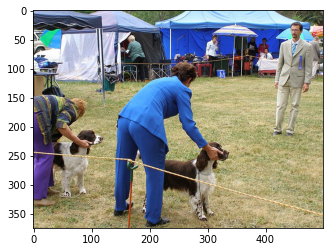

5782


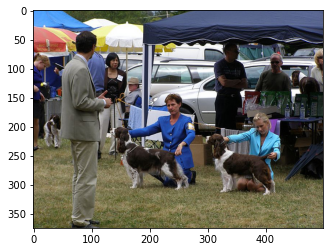

6121


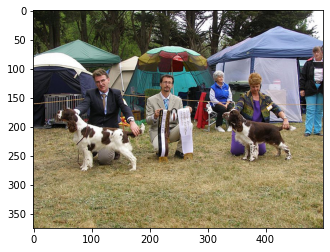

6376


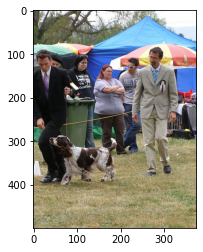

6141


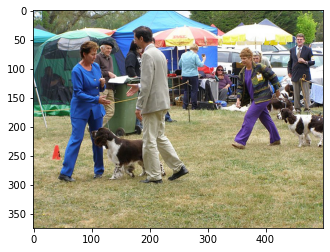

6293


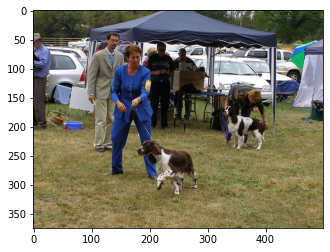

6364


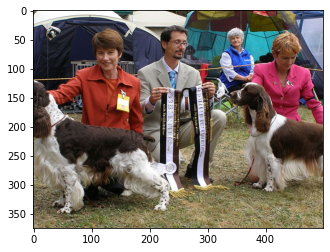

6350


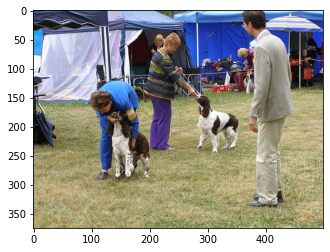

6058


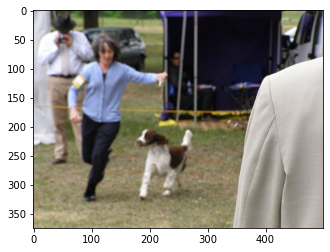

5898


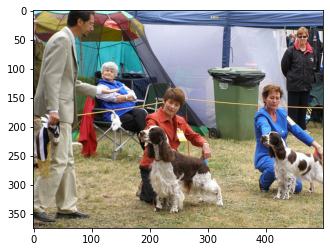

In [37]:
idx, xc = get_top_k(xq)

Plenty of dog shows!

Now that we've finished optimizing the model weights, we can save it to file.

In [38]:
with open("classifier.pth", "wb") as f:
    torch.save(model, f)

---